<a href="https://colab.research.google.com/github/kathleenyi/Hospital-Staff-Shortage-Forecast/blob/main/COVID_Staff_Shortage_Multivariate_Time_Series_Forecast_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
pd.options.display.max_rows = None
pd.options.display.max_columns = None

In [ ]:
raw_data = pd.read_csv("/COVID-19_Reported_Patient_Impact_and_Hospital_Capacity_by_State_Timeseries__RAW__20240223.csv")

In [ ]:
raw_data.head()

,state,date,critical_staffing_shortage_today_yes,critical_staffing_shortage_today_no,critical_staffing_shortage_today_not_reported,critical_staffing_shortage_anticipated_within_week_yes,critical_staffing_shortage_anticipated_within_week_no,critical_staffing_shortage_anticipated_within_week_not_reported,hospital_onset_covid,hospital_onset_covid_coverage,inpatient_beds,inpatient_beds_coverage,inpatient_beds_used,inpatient_beds_used_coverage,inpatient_beds_used_covid,inpatient_beds_used_covid_coverage,previous_day_admission_adult_covid_confirmed,previous_day_admission_adult_covid_confirmed_coverage,previous_day_admission_adult_covid_suspected,previous_day_admission_adult_covid_suspected_coverage,previous_day_admission_pediatric_covid_confirmed,previous_day_admission_pediatric_covid_confirmed_coverage,previous_day_admission_pediatric_covid_suspected,previous_day_admission_pediatric_covid_suspected_coverage,staffed_adult_icu_bed_occupancy,staffed_adult_icu_bed_occupancy_coverage,staffed_icu_adult_patients_confirmed_and_suspected_covid,staffed_icu_adult_patients_confirmed_and_suspected_covid_coverage,staffed_icu_adult_patients_confirmed_covid,staffed_icu_adult_patients_confirmed_covid_coverage,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_adult_patients_hospitalized_confirmed_and_suspected_covid_coverage,total_adult_patients_hospitalized_confirmed_covid,total_adult_patients_hospitalized_confirmed_covid_coverage,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid_coverage,total_pediatric_patients_hospitalized_confirmed_covid,total_pediatric_patients_hospitalized_confirmed_covid_coverage,total_staffed_adult_icu_beds,total_staffed_adult_icu_beds_coverage,inpatient_beds_utilization,inpatient_beds_utilization_coverage,inpatient_beds_utilization_numerator,inpatient_beds_utilization_denominator,percent_of_inpatients_with_covid,percent_of_inpatients_with_covid_coverage,percent_of_inpatients_with_covid_numerator,percent_of_inpatients_with_covid_denominator,inpatient_bed_covid_utilization,inpatient_bed_covid_utilization_coverage,inpatient_bed_covid_utilization_numerator,inpatient_bed_covid_utilization_denominator,adult_icu_bed_covid_utilization,adult_icu_bed_covid_utilization_coverage,adult_icu_bed_covid_utilization_numerator,adult_icu_bed_covid_utilization_denominator,adult_icu_bed_utilization,adult_icu_bed_utilization_coverage,adult_icu_bed_utilization_numerator,adult_icu_bed_utilization_denominator,geocoded_state,previous_day_admission_adult_covid_confirmed_18-19,previous_day_admission_adult_covid_confirmed_18-19_coverage,previous_day_admission_adult_covid_confirmed_20-29,previous_day_admission_adult_covid_confirmed_20-29_coverage,previous_day_admission_adult_covid_confirmed_30-39,previous_day_admission_adult_covid_confirmed_30-39_coverage,previous_day_admission_adult_covid_confirmed_40-49,previous_day_admission_adult_covid_confirmed_40-49_coverage,previous_day_admission_adult_covid_confirmed_50-59,previous_day_admission_adult_covid_confirmed_50-59_coverage,previous_day_admission_adult_covid_confirmed_60-69,previous_day_admission_adult_covid_confirmed_60-69_coverage,previous_day_admission_adult_covid_confirmed_70-79,previous_day_admission_adult_covid_confirmed_70-79_coverage,previous_day_admission_adult_covid_confirmed_80+,previous_day_admission_adult_covid_confirmed_80+_coverage,previous_day_admission_adult_covid_confirmed_unknown,previous_day_admission_adult_covid_confirmed_unknown_coverage,previous_day_admission_adult_covid_suspected_18-19,previous_day_admission_adult_covid_suspected_18-19_coverage,previous_day_admission_adult_covid_suspected_20-29,previous_day_admission_adult_covid_suspected_20-29_coverage,previous_day_admission_adult_covid_suspected_30-39,previous_day_admission_adult_covid_suspected_30-39_coverage,previous_day_admission_adult_covid_suspected_40-49,previous_day_admission_adult_covid_suspected_40-49_coverage,previ

Let's convert string/object date column into actual date type and sort ascending

In [ ]:
print(type(raw_data.date[2]))
raw_data.date.dtype

<class 'str'>


dtype('O')

In [ ]:
raw_data.date = pd.to_datetime(raw_data.date, format='%Y/%m/%d')

In [ ]:
raw_data = raw_data.sort_values(['date'],ascending = True, ignore_index = True) #raw_data.date doesn't work?? tries to sort through as pandas series
raw_data

,state,date,critical_staffing_shortage_today_yes,critical_staffing_shortage_today_no,critical_staffing_shortage_today_not_reported,critical_staffing_shortage_anticipated_within_week_yes,critical_staffing_shortage_anticipated_within_week_no,critical_staffing_shortage_anticipated_within_week_not_reported,hospital_onset_covid,hospital_onset_covid_coverage,inpatient_beds,inpatient_beds_coverage,inpatient_beds_used,inpatient_beds_used_coverage,inpatient_beds_used_covid,inpatient_beds_used_covid_coverage,previous_day_admission_adult_covid_confirmed,previous_day_admission_adult_covid_confirmed_coverage,previous_day_admission_adult_covid_suspected,previous_day_admission_adult_covid_suspected_coverage,previous_day_admission_pediatric_covid_confirmed,previous_day_admission_pediatric_covid_confirmed_coverage,previous_day_admission_pediatric_covid_suspected,previous_day_admission_pediatric_covid_suspected_coverage,staffed_adult_icu_bed_occupancy,staffed_adult_icu_bed_occupancy_coverage,staffed_icu_adult_patients_confirmed_and_suspected_covid,staffed_icu_adult_patients_confirmed_and_suspected_covid_coverage,staffed_icu_adult_patients_confirmed_covid,staffed_icu_adult_patients_confirmed_covid_coverage,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_adult_patients_hospitalized_confirmed_and_suspected_covid_coverage,total_adult_patients_hospitalized_confirmed_covid,total_adult_patients_hospitalized_confirmed_covid_coverage,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid_coverage,total_pediatric_patients_hospitalized_confirmed_covid,total_pediatric_patients_hospitalized_confirmed_covid_coverage,total_staffed_adult_icu_beds,total_staffed_adult_icu_beds_coverage,inpatient_beds_utilization,inpatient_beds_utilization_coverage,inpatient_beds_utilization_numerator,inpatient_beds_utilization_denominator,percent_of_inpatients_with_covid,percent_of_inpatients_with_covid_coverage,percent_of_inpatients_with_covid_numerator,percent_of_inpatients_with_covid_denominator,inpatient_bed_covid_utilization,inpatient_bed_covid_utilization_coverage,inpatient_bed_covid_utilization_numerator,inpatient_bed_covid_utilization_denominator,adult_icu_bed_covid_utilization,adult_icu_bed_covid_utilization_coverage,adult_icu_bed_covid_utilization_numerator,adult_icu_bed_covid_utilization_denominator,adult_icu_bed_utilization,adult_icu_bed_utilization_coverage,adult_icu_bed_utilization_numerator,adult_icu_bed_utilization_denominator,geocoded_state,previous_day_admission_adult_covid_confirmed_18-19,previous_day_admission_adult_covid_confirmed_18-19_coverage,previous_day_admission_adult_covid_confirmed_20-29,previous_day_admission_adult_covid_confirmed_20-29_coverage,previous_day_admission_adult_covid_confirmed_30-39,previous_day_admission_adult_covid_confirmed_30-39_coverage,previous_day_admission_adult_covid_confirmed_40-49,previous_day_admission_adult_covid_confirmed_40-49_coverage,previous_day_admission_adult_covid_confirmed_50-59,previous_day_admission_adult_covid_confirmed_50-59_coverage,previous_day_admission_adult_covid_confirmed_60-69,previous_day_admission_adult_covid_confirmed_60-69_coverage,previous_day_admission_adult_covid_confirmed_70-79,previous_day_admission_adult_covid_confirmed_70-79_coverage,previous_day_admission_adult_covid_confirmed_80+,previous_day_admission_adult_covid_confirmed_80+_coverage,previous_day_admission_adult_covid_confirmed_unknown,previous_day_admission_adult_covid_confirmed_unknown_coverage,previous_day_admission_adult_covid_suspected_18-19,previous_day_admission_adult_covid_suspected_18-19_coverage,previous_day_admission_adult_covid_suspected_20-29,previous_day_admission_adult_covid_suspected_20-29_coverage,previous_day_admission_adult_covid_suspected_30-39,previous_day_admission_adult_covid_suspected_30-39_coverage,previous_day_admission_adult_covid_suspected_40-49,previous_day_admission_adult_covid_suspected_40-49_coverage,previ

In [ ]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1448 entries, 0 to 1447
Columns: 135 entries, state to total_staffed_pediatric_icu_beds_coverage
dtypes: datetime64[ns](1), float64(75), int64(58), object(1)
memory usage: 1.5+ MB


**DATA PREPROCESSING**

Let's see what we're working with visually with the target variable, *critical_staffing_shortage_today_yes* - trend, seasonality, noise?

<Figure size 640x480 with 0 Axes>

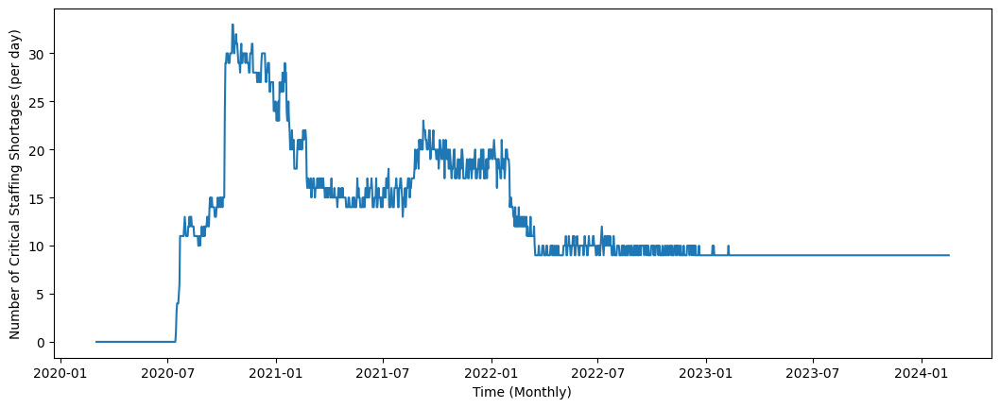

In [ ]:
fig_width, fig_height = plt.gcf().get_size_inches()
plt.figure(figsize=(fig_width*2,fig_height))
plt.plot(raw_data.date, raw_data.critical_staffing_shortage_today_yes)
plt.xlabel("Time (Monthly)")
plt.ylabel("Number of Critical Staffing Shortages (per day)")
plt.show()

We have a clear issue starting from the beginning of 2023, where the value is constant (9). Upon further research, this may be related to the fact that these reported values are only coming from one VA hospital, as others have slowly stopped reporting their statistics. This is a data entry related issue. *THIS WILL BE OUR NEXT STEP! To remove or not to remove? To impute or not to impute?

Text(0.5, 1.0, 'Closer Zoom')

<Figure size 640x480 with 0 Axes>

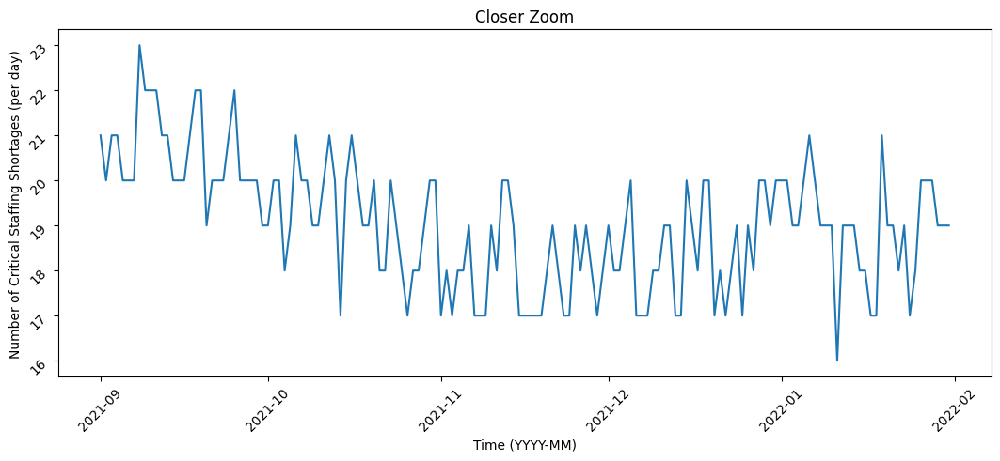

In [ ]:
fig_width, fig_height = plt.gcf().get_size_inches()
plt.figure(figsize=(fig_width*2,fig_height))
plt.plot(raw_data.date[548:701], raw_data.critical_staffing_shortage_today_yes[548:701])
plt.tick_params(rotation=45)
plt.xlabel("Time (YYYY-MM)")
plt.ylabel("Number of Critical Staffing Shortages (per day)")
plt.title("Closer Zoom")

Real world data is messy and not easy to work with -- looks like our data is non stationary. We definitely have a general downwards trend and noise. Perhaps some seasonality. **Need to look into seasonality more!<br>


In [ ]:
#import statsmodels
#from statsmodels.tsa.seasonal import seasonal_decompose

In [ ]:
#plt.rc('figure', figsize =(12,8))
#plt.rc('font', size=15)
#result = seasonal_decompose(raw_data.loc[549:701, ['date','critical_staffing_shortage_today_yes']], period=30)

In [ ]:
#x = raw_data.columns.tolist()
#x

135 features, many of them paired. <br>
E.g.: "inpatient beds used" & "inpatient beds coverage" <br>
"coverage" = number of hospitals reporting variable in respective state <br> *finding lots of these values are extremely low (1, 2); also missing lots of data*<br> No categorical variables except *state*, but for now we are focusing on data in one state


Time for some feature selection.<br>
We're using filter methods to rank features based on correlation. <br><br>
Target variable (count, continuous): *critical_staffing_shortage_today_yes*<br>
Let's determine correlation for each feature with our target variable using cross correlation.

In [ ]:
target_series = raw_data.critical_staffing_shortage_today_yes.to_numpy()

In [ ]:
import statsmodels.api as sm

In [ ]:
def get_correlations(feature_series):
  cross_cor = sm.tsa.stattools.ccf(target_series, feature_series, adjusted=False)
  return cross_cor

In [ ]:
ccf_features = []
for feature in raw_data.columns[3:]:
  print(get_correlations(raw_data[feature]))
  cor_vals = get_correlations(raw_data[feature])
  for val in cor_vals:
    if val >= (0.5 or -0.5):
      ccf_features.append(feature)
      break

[7.33666473e-01 7.31456000e-01 7.27495003e-01 ... 2.02870775e-03
 1.35247184e-03 6.76235918e-04]
[-6.78120299e-01 -6.75643117e-01 -6.72494320e-01 ...  1.41187290e-03
  9.41248601e-04  4.70624301e-04]
[9.19848108e-01 9.14221399e-01 9.09205256e-01 ... 1.94540164e-03
 1.29693442e-03 6.48467212e-04]
[0.70114021 0.69747021 0.69246857 ... 0.00253904 0.00169269 0.00084635]
[-6.60106793e-01 -6.56802375e-01 -6.52651106e-01 ...  1.36637826e-03
  9.10918837e-04  4.55459419e-04]
[nan nan nan ... nan nan nan]
[0.62783321 0.62357296 0.61918074 ... 0.00383992 0.00255994 0.00127997]
[0.61400805 0.61091415 0.60772818 ... 0.00480135 0.0032009  0.00160045]
[0.59211624 0.5871587  0.58190924 ... 0.00485674 0.00323782 0.00161891]
[nan nan nan ... nan nan nan]
[0.60139864 0.59629342 0.59089619 ... 0.00490836 0.00327224 0.00163612]
[5.96118719e-01 5.93381766e-01 5.89822547e-01 ... 1.17249757e-03
 7.81665050e-04 3.90832525e-04]
[0.57673943 0.57363929 0.57021219 ... 0.00391192 0.00260795 0.00130397]
[nan nan na

/usr/local/lib/python3.10/dist-packages/scipy/signal/_signaltools.py:242: RuntimeWarning: Use of fft convolution on input with NAN or inf results in NAN or inf output. Consider using method='direct' instead.
  return convolve(in1, _reverse_and_conj(in2), mode, method)



[nan nan nan ... nan nan nan]
[0.65660616 0.65359237 0.65001139 ... 0.00287752 0.00191835 0.00095917]
[nan nan nan ... nan nan nan]
[0.70865285 0.70573403 0.70223947 ... 0.00256795 0.00171197 0.00085598]
[nan nan nan ... nan nan nan]
[0.65324364 0.65051398 0.64706569 ... 0.00287718 0.00191812 0.00095906]
[nan nan nan ... nan nan nan]
[0.65740318 0.65362729 0.64944344 ... 0.00285677 0.00190451 0.00095226]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan nan nan]
[nan nan nan ... nan 

In [ ]:
ccf_features

['critical_staffing_shortage_today_no',
 'critical_staffing_shortage_anticipated_within_week_yes',
 'critical_staffing_shortage_anticipated_within_week_no',
 'hospital_onset_covid_coverage',
 'inpatient_beds',
 'inpatient_beds_coverage',
 'inpatient_beds_used_coverage',
 'inpatient_beds_used_covid',
 'inpatient_beds_used_covid_coverage',
 'previous_day_admission_adult_covid_confirmed_coverage',
 'previous_day_admission_adult_covid_suspected_coverage',
 'previous_day_admission_pediatric_covid_confirmed_coverage',
 'previous_day_admission_pediatric_covid_suspected_coverage',
 'staffed_adult_icu_bed_occupancy_coverage',
 'staffed_icu_adult_patients_confirmed_and_suspected_covid_coverage',
 'staffed_icu_adult_patients_confirmed_covid_coverage',
 'total_adult_patients_hospitalized_confirmed_and_suspected_covid_coverage',
 'total_adult_patients_hospitalized_confirmed_covid_coverage',
 'total_pediatric_patients_hospitalized_confirmed_and_suspected_covid_coverage',
 'total_pediatric_patients_h

Generally, keeping features with their first few lags greater than cross correlation > +/-0.5. <br> However, our list only contains features that did not have any missing values due to how ccf function works. We still need to evaluate the other features with missing values and see what's viable and add it to our list.

In [ ]:
raw_data.isnull().sum()

state                                                                              0
date                                                                               0
critical_staffing_shortage_today_yes                                               0
critical_staffing_shortage_today_no                                                0
critical_staffing_shortage_today_not_reported                                      0
critical_staffing_shortage_anticipated_within_week_yes                             0
critical_staffing_shortage_anticipated_within_week_no                              0
critical_staffing_shortage_anticipated_within_week_not_reported                    0
hospital_onset_covid                                                              21
hospital_onset_covid_coverage                                                      0
inpatient_beds                                                                     0
inpatient_beds_coverage                                          

Using domain knowledge, here are the features with missing values that may influence our target. We will evaluate:<br>
*hospital_onset_covid*: patients with suspected or confirmed covid after admission to hopsital for something unrelated<br>
*inpatient_beds_used*  <br>
*total_adult_patients_hospitalized_confirmed_and_suspected_covid
total_pediatric_patients_hospitalized_confirmed_and_suspected_covid <br>
deaths_covid<br>
total_patients_hospitalized_confirmed_influenza*

We're also going to use domain knowledge to remove some features from ccf_features. We're going to keep:
*critical_staffing_shortage_anticipated_within_week_yes*<br>
Most of the values in ccf_features were "coverage", meaning there is too much of a correlation with its corresponding pair.<br>
*Look into this too! Recheck so-called "domain-knowledge".

Let's create a new and improved dataframe with the features that we want. We're also going to remove the 'state' feature, since we are only analyzing within VA for now

In [ ]:
clean_data = raw_data.copy()

In [ ]:
new_features = []
new_features.extend(['critical_staffing_shortage_anticipated_within_week_yes', 'inpatient_beds_used', 'total_adult_patients_hospitalized_confirmed_and_suspected_covid', 'total_pediatric_patients_hospitalized_confirmed_and_suspected_covid', 'deaths_covid', 'total_patients_hospitalized_confirmed_influenza'])
new_features

['critical_staffing_shortage_anticipated_within_week_yes',
 'inpatient_beds_used',
 'total_adult_patients_hospitalized_confirmed_and_suspected_covid',
 'total_pediatric_patients_hospitalized_confirmed_and_suspected_covid',
 'deaths_covid',
 'total_patients_hospitalized_confirmed_influenza']

In [ ]:
for col in raw_data.columns:
  if col not in new_features and col !='date' and col != 'critical_staffing_shortage_today_yes':
    clean_data.drop(col, axis=1, inplace=True)

In [ ]:
clean_data.columns

Index(['date', 'critical_staffing_shortage_today_yes',
       'critical_staffing_shortage_anticipated_within_week_yes',
       'inpatient_beds_used',
       'total_adult_patients_hospitalized_confirmed_and_suspected_covid',
       'total_pediatric_patients_hospitalized_confirmed_and_suspected_covid',
       'deaths_covid', 'total_patients_hospitalized_confirmed_influenza'],
      dtype='object')

In [ ]:
clean_data.shape

(1448, 8)

In [ ]:
clean_data

,date,critical_staffing_shortage_today_yes,critical_staffing_shortage_anticipated_within_week_yes,inpatient_beds_used,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,deaths_covid,total_patients_hospitalized_confirmed_influenza
0,2020-03-02,0,0,NaN,NaN,NaN,NaN,NaN
1,2020-03-03,0,0,NaN,NaN,NaN,NaN,NaN
2,2020-03-04,0,0,NaN,NaN,NaN,NaN,NaN
3,2020-03-05,0,0,NaN,NaN,NaN,NaN,NaN
4,2020-03-06,0,0,NaN,NaN,NaN,NaN,NaN
5,2020-03-07,0,0,NaN,NaN,NaN,NaN,NaN
6,2020-03-08,0,0,NaN,NaN,NaN,NaN,NaN
7,2020-03-09,0,0,NaN,NaN,NaN,NaN,NaN
8,2020-03-10,0,0,NaN,NaN,NaN,NaN,NaN
9,2020-03-11,0,0,NaN,NaN,NaN,NaN,NaN


Now we can finally start to analyze and perform some EDA our selected features with pandas profiling (ideally, I would've liked to profile the entire raw dataset, but Colab didn't support that much RAM capacity)

In [ ]:
#! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [ ]:
#import pandas_profiling # bit of a cheat sheet. getting overall report of our dataset!

In [ ]:
#from pandas_profiling import ProfileReport
#profile = ProfileReport(clean_data, tsmode=True, sortby='date')
#profile.to_file('profile_report.html')

Quick text summary of our report (we'll visualize some of the more important features below)<br>

*   4.7% of our data is missing - across all features and our target variable, but influenza column has the highest percent missing!
*   Our data is NON STATIONARY! (based on augmented dickey fuller test--also, we confirmed this with our target variable above)
****critical_staffing_shortage_today_yes, total_adult_patients_hospitalized_confirmed_and_suspected_covid, total_pediatric_patients_hospitalized_confirmed_and_suspected_covid, deaths_covid, total_patients_hospitalized_confirmed_influenza*** are all seasonal
* Our features all seem to be correlated with our target variable - *note to self: look into influenza and suspected covid variables! They seem a little suspicious



Let's look at a correlation matrix heatmap as well as visualize the seasonality of the variables mentioned above.

In [ ]:
no_time = clean_data.drop(['date'], axis=1)

In [ ]:
import seaborn as sns

<Axes: >

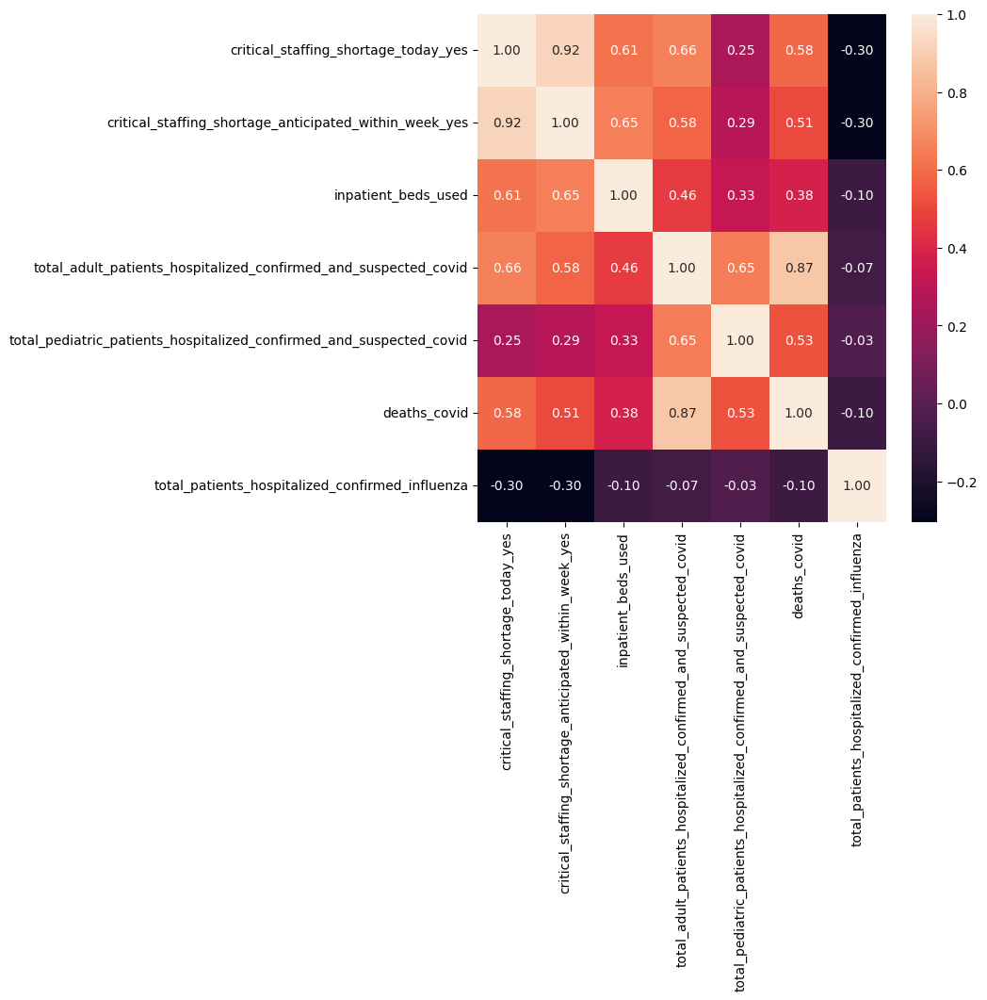

In [ ]:
plt.figure(figsize=(7,7))
sns.heatmap(no_time.corr(), annot = True, fmt = '.2f')

The seaborn correlation matrix heatmap has slightly different correlation values than the one produced from pandas profiling. But analyzing the two, we can conclude that the features -- influenza and pediatric -- have the lowest correlation with our target variable (~-0.30-0.41 and ~0.25-0.44, respectively). There is also a relatively high correlation between COVID deaths and adults. We can consider removing/engineering these if our model ends up overfitting.

<Figure size 640x480 with 0 Axes>

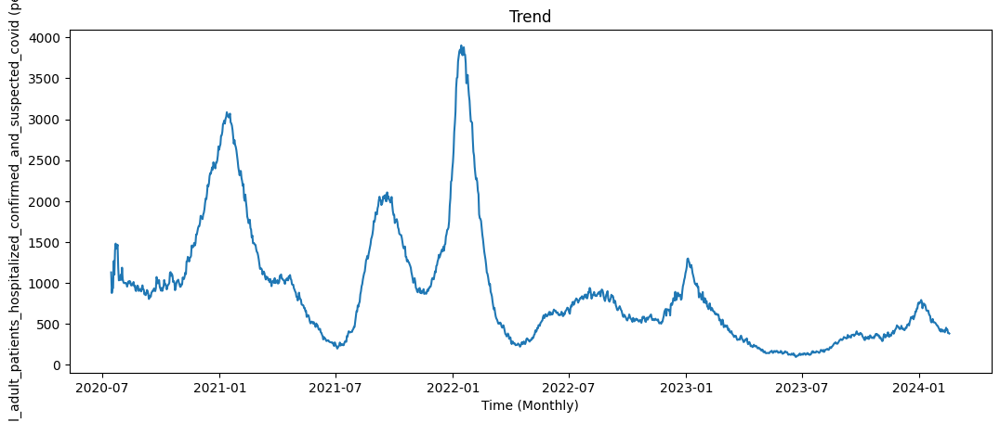

In [ ]:
fig_width, fig_height = plt.gcf().get_size_inches()
plt.figure(figsize=(fig_width*2,fig_height))
plt.plot(raw_data.date, raw_data.total_adult_patients_hospitalized_confirmed_and_suspected_covid)
plt.xlabel("Time (Monthly)")
plt.ylabel("total_adult_patients_hospitalized_confirmed_and_suspected_covid (per day)")
plt.title("Trend")
plt.show()

Hospitalization for COVID in adults seems to peak in late January while dipping low in July.

<Figure size 640x480 with 0 Axes>

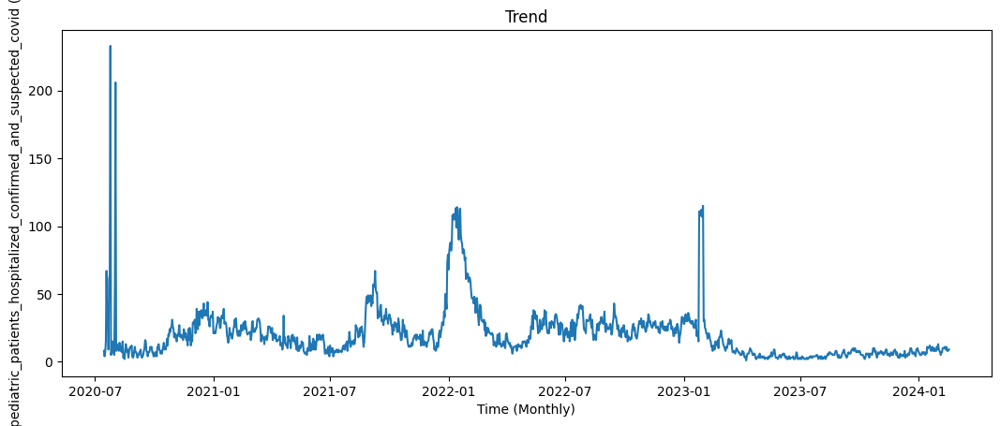

In [ ]:
fig_width, fig_height = plt.gcf().get_size_inches()
plt.figure(figsize=(fig_width*2,fig_height))
plt.plot(raw_data.date, raw_data.total_pediatric_patients_hospitalized_confirmed_and_suspected_covid)
plt.xlabel("Time (Monthly)")
plt.ylabel("total_pediatric_patients_hospitalized_confirmed_and_suspected_covid (per day)")
plt.title("Trend")
plt.show()

Similar reports for the pediatric population. However, the data is a lot noisier and we can only clearly see peak seasonality trends.

<Figure size 640x480 with 0 Axes>

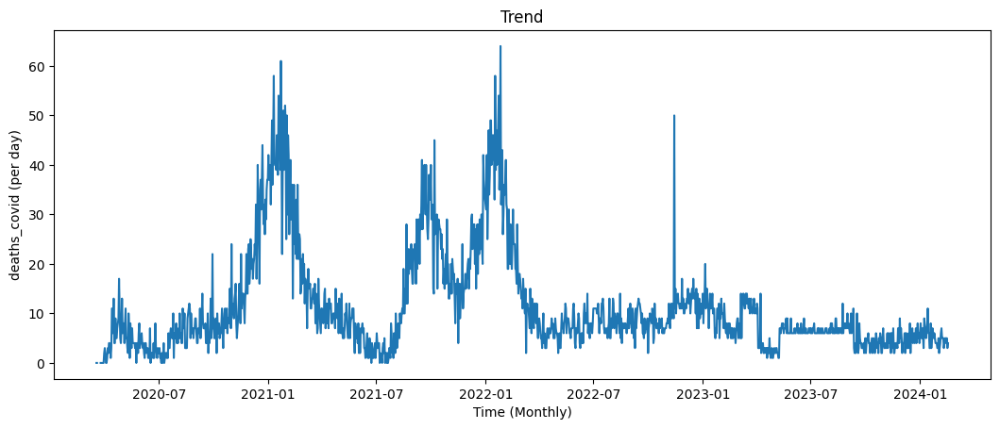

In [ ]:
fig_width, fig_height = plt.gcf().get_size_inches()
plt.figure(figsize=(fig_width*2,fig_height))
plt.plot(raw_data.date, raw_data.deaths_covid)
plt.xlabel("Time (Monthly)")
plt.ylabel("deaths_covid (per day)")
plt.title("Trend")
plt.show()

This one follows a relatively similar trend as well, but much harder to detect. Regardless, a clear peak in seasonality in late January.

<Figure size 640x480 with 0 Axes>

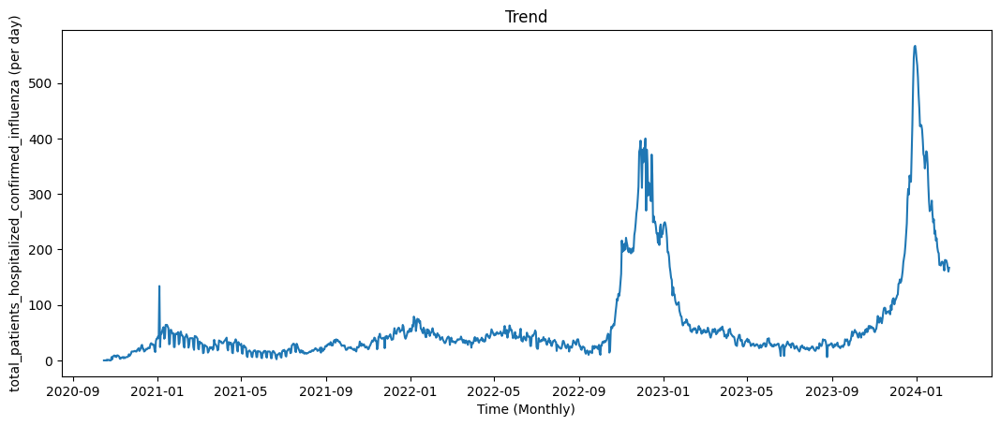

In [ ]:
fig_width, fig_height = plt.gcf().get_size_inches()
plt.figure(figsize=(fig_width*2,fig_height))
plt.plot(raw_data.date, raw_data.total_patients_hospitalized_confirmed_influenza)
plt.xlabel("Time (Monthly)")
plt.ylabel("total_patients_hospitalized_confirmed_influenza (per day)")
plt.title("Trend")
plt.show()

Influenza hospitalization seems to peak around December to January - slightly earlier than COVID.

Most of our features have missing data. Let's impute them.<br>
Right off the bat, we can see that we're missing tons of data across almost all features up til 2020-07-14 (index 134), presumably because data collection regarding COVID statistics didn't start until around this time. We will go ahead and remove those points, though at the risk of losing some data from some of our feature variables (inpatient beds used and COVID deaths).

In [ ]:
clean_data.drop(clean_data.index[0:135], axis=0, inplace=True)
clean_data

,date,critical_staffing_shortage_today_yes,critical_staffing_shortage_anticipated_within_week_yes,inpatient_beds_used,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,deaths_covid,total_patients_hospitalized_confirmed_influenza
135,2020-07-15,1,1,8297.0,1129.0,8.0,2.0,NaN
136,2020-07-16,3,3,8552.0,876.0,4.0,1.0,NaN
137,2020-07-17,4,4,8448.0,931.0,7.0,6.0,NaN
138,2020-07-18,4,4,8007.0,935.0,15.0,3.0,NaN
139,2020-07-19,4,4,7492.0,1266.0,67.0,3.0,NaN
140,2020-07-20,5,5,7971.0,1101.0,24.0,6.0,NaN
141,2020-07-21,6,6,8244.0,1395.0,42.0,7.0,NaN
142,2020-07-22,11,11,10512.0,1480.0,9.0,6.0,NaN
143,2020-07-23,11,12,11638.0,1418.0,61.0,5.0,NaN
144,2020-07-24,11,13,11438.0,1432.0,64.0,5.0,NaN


In [ ]:
clean_data.reset_index(drop=True, inplace=True) #reorder what we dropped

Let's see what's missing now:

In [ ]:
clean_data.isnull().sum()

date                                                                    0
critical_staffing_shortage_today_yes                                    0
critical_staffing_shortage_anticipated_within_week_yes                  0
inpatient_beds_used                                                     0
total_adult_patients_hospitalized_confirmed_and_suspected_covid         0
total_pediatric_patients_hospitalized_confirmed_and_suspected_covid     0
deaths_covid                                                            0
total_patients_hospitalized_confirmed_influenza                        93
dtype: int64

Great! All we need to do is impute data for the last feature: *total_patients_hospitalized_confirmed_influenza* <br>It seems to be only missing some data in the beginning data points, so the go to method, linear interpolation, can't be used to fill in the gap. <br> Let's use KNN instead.

In [ ]:
clean_data.date = clean_data.date.values.astype("float64") #to use KNNImputer, it won't take datetime64 as value. Need to convert to float first and we can convert back after

In [ ]:
import sklearn
from sklearn.impute import KNNImputer

In [ ]:
KNN = KNNImputer(missing_values=np.NaN)
imp_data = pd.DataFrame(KNN.fit_transform(clean_data))
imp_data.columns=clean_data.columns
imp_data.index=clean_data.index

In [ ]:
imp_data.date = imp_data.date.values.astype("datetime64[ns]") # back to pd time format

In [ ]:
imp_data.isnull().sum() # no more missing values!

date                                                                   0
critical_staffing_shortage_today_yes                                   0
critical_staffing_shortage_anticipated_within_week_yes                 0
inpatient_beds_used                                                    0
total_adult_patients_hospitalized_confirmed_and_suspected_covid        0
total_pediatric_patients_hospitalized_confirmed_and_suspected_covid    0
deaths_covid                                                           0
total_patients_hospitalized_confirmed_influenza                        0
dtype: int64

In [ ]:
imp_data.describe()

,critical_staffing_shortage_today_yes,critical_staffing_shortage_anticipated_within_week_yes,inpatient_beds_used,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,deaths_covid,total_patients_hospitalized_confirmed_influenza
count,1313.000000,1313.000000,1313.000000,1313.000000,1313.000000,1313.00000,1313.000000
mean,13.404417,18.935263,12372.508759,900.194212,19.961158,12.02818,60.124600
std,5.895964,6.723837,959.963461,728.846694,19.185929,10.50370,85.342041
min,1.000000,1.000000,7492.000000,94.000000,1.000000,0.00000,0.000000
25%,9.000000,16.000000,11772.000000,377.000000,8.000000,6.00000,21.000000
50%,10.000000,18.000000,12355.000000,711.000000,16.000000,8.00000,34.000000
75%,17.000000,21.000000,13092.000000,1066.000000,26.000000,14.00000,52.000000
max,33.000000,42.000000,14344.000000,3903.000000,233.000000,64.00000,567.000000


Mean vs median (50%) doesn't look too concerning, but looking at 75% and max rows, there's potential for outliers. Suspicions lie with the peak of COVID, so we're going to keep the datapoints as they represent real world data. *Make sure they don't make up more than 15% of the data *according to report they only make up 4.7%!

Let's standardize our data and split it into train and test sets. <br>



In [ ]:
#imp_data =imp_data.set_index('date')

In [ ]:
imp_data.head()

,date,critical_staffing_shortage_today_yes,critical_staffing_shortage_anticipated_within_week_yes,inpatient_beds_used,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,deaths_covid,total_patients_hospitalized_confirmed_influenza
0,2020-07-15,1.0,1.0,8297.0,1129.0,8.0,2.0,0.2
1,2020-07-16,3.0,3.0,8552.0,876.0,4.0,1.0,0.2
2,2020-07-17,4.0,4.0,8448.0,931.0,7.0,6.0,0.2
3,2020-07-18,4.0,4.0,8007.0,935.0,15.0,3.0,0.2
4,2020-07-19,4.0,4.0,7492.0,1266.0,67.0,3.0,0.2


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import TimeSeriesSplit

In [ ]:
X = imp_data.drop(labels='critical_staffing_shortage_today_yes', axis=1)
X.head()

,date,critical_staffing_shortage_anticipated_within_week_yes,inpatient_beds_used,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,deaths_covid,total_patients_hospitalized_confirmed_influenza
0,2020-07-15,1.0,8297.0,1129.0,8.0,2.0,0.2
1,2020-07-16,3.0,8552.0,876.0,4.0,1.0,0.2
2,2020-07-17,4.0,8448.0,931.0,7.0,6.0,0.2
3,2020-07-18,4.0,8007.0,935.0,15.0,3.0,0.2
4,2020-07-19,4.0,7492.0,1266.0,67.0,3.0,0.2


In [ ]:
for_scaling = X.drop(['date'], axis=1)
for_scaling.head()

,critical_staffing_shortage_anticipated_within_week_yes,inpatient_beds_used,total_adult_patients_hospitalized_confirmed_and_suspected_covid,total_pediatric_patients_hospitalized_confirmed_and_suspected_covid,deaths_covid,total_patients_hospitalized_confirmed_influenza
0,1.0,8297.0,1129.0,8.0,2.0,0.2
1,3.0,8552.0,876.0,4.0,1.0,0.2
2,4.0,8448.0,931.0,7.0,6.0,0.2
3,4.0,8007.0,935.0,15.0,3.0,0.2
4,4.0,7492.0,1266.0,67.0,3.0,0.2


In [ ]:
scaler = StandardScaler()
fit = scaler.fit(for_scaling)
for_scaling_array = fit.transform(for_scaling)
print(for_scaling_array)

[[-2.66843125 -4.24710085  0.31404817 -0.62367141 -0.95509209 -0.7024373 ]
 [-2.3708687  -3.98136452 -0.03320785 -0.83223697 -1.05033292 -0.7024373 ]
 [-2.22208743 -4.08974326  0.04228259 -0.6758128  -0.5741288  -0.7024373 ]
 ...
 [-1.18061851 -0.04950903 -0.70575903 -0.62367141 -0.66936962  1.25279547]
 [-1.18061851 -0.17560352 -0.70164137 -0.57153001 -0.85985127  1.17074133]
 [-1.18061851 -0.71853931 -0.71262179 -0.57153001 -0.76461045  1.25279547]]


In [ ]:
for_scaling_array = for_scaling_array.T
print(for_scaling_array)

[[-2.66843125 -2.3708687  -2.22208743 ... -1.18061851 -1.18061851
  -1.18061851]
 [-4.24710085 -3.98136452 -4.08974326 ... -0.04950903 -0.17560352
  -0.71853931]
 [ 0.31404817 -0.03320785  0.04228259 ... -0.70575903 -0.70164137
  -0.71262179]
 [-0.62367141 -0.83223697 -0.6758128  ... -0.62367141 -0.57153001
  -0.57153001]
 [-0.95509209 -1.05033292 -0.5741288  ... -0.66936962 -0.85985127
  -0.76461045]
 [-0.7024373  -0.7024373  -0.7024373  ...  1.25279547  1.17074133
   1.25279547]]


In [ ]:
for array, col in zip(for_scaling_array, for_scaling.columns):
  X[col] = array

In [ ]:
print(X)

           date  critical_staffing_shortage_anticipated_within_week_yes  \
0    2020-07-15                                          -2.668431        
1    2020-07-16                                          -2.370869        
2    2020-07-17                                          -2.222087        
3    2020-07-18                                          -2.222087        
4    2020-07-19                                          -2.222087        
5    2020-07-20                                          -2.073306        
6    2020-07-21                                          -1.924525        
7    2020-07-22                                          -1.180619        
8    2020-07-23                                          -1.031837        
9    2020-07-24                                          -0.883056        
10   2020-07-25                                          -0.883056        
11   2020-07-26                                          -0.883056        
12   2020-07-27          

In [ ]:
Y = imp_data.critical_staffing_shortage_today_yes
Y.head()

0    1.0
1    3.0
2    4.0
3    4.0
4    4.0
Name: critical_staffing_shortage_today_yes, dtype: float64

In [ ]:
split = TimeSeriesSplit()

In [ ]:
for train_index, test_index in split.split(X):
  X_train, X_test = X.loc[train_index, :], X.loc[test_index, :]
  Y_train, Y_test = Y.loc[train_index], Y.loc[test_index]
  print("Train", train_index, "Test:", test_index)


Train [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222] Test: [223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240
 241 242 

In [ ]:
print(X_train)

           date  critical_staffing_shortage_anticipated_within_week_yes  \
0    2020-07-15                                          -2.668431        
1    2020-07-16                                          -2.370869        
2    2020-07-17                                          -2.222087        
3    2020-07-18                                          -2.222087        
4    2020-07-19                                          -2.222087        
5    2020-07-20                                          -2.073306        
6    2020-07-21                                          -1.924525        
7    2020-07-22                                          -1.180619        
8    2020-07-23                                          -1.031837        
9    2020-07-24                                          -0.883056        
10   2020-07-25                                          -0.883056        
11   2020-07-26                                          -0.883056        
12   2020-07-27          

In [ ]:
X_train.shape

(1095, 7)

Let's create a deep learning network using LSTM.

In [ ]:
#X_train, Y_train = np.array(X_train), np.array(Y_train)

In [ ]:
dropped_X_train = X_train.drop(labels='date', axis=1) #doesn't take timestamp, don't need it for our model

In [ ]:
dropped_X_train, Y_train = np.array(dropped_X_train), np.array(Y_train)

In [ ]:
# Reshape the input data to have the correct dimensions. timestep =1
dropped_X_train = dropped_X_train.reshape(dropped_X_train.shape[0], 1, dropped_X_train.shape[1])

In [ ]:
dropped_X_train.shape

(1095, 1, 6)

In [ ]:
Y_train.shape

(1095,)

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dropout, Dense, LSTM

In [ ]:
model = Sequential()
model.add(LSTM(32, input_shape=(1,6), return_sequences=True)) #default activation is tanh
model.add(LSTM(32, return_sequences=True, dropout = 0.2))
model.add(Dense(1)) #None will use linear activation func
model.compile(optimizer='adam', loss='mse', metrics='mae')

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 1, 32)             4992      
                                                                 
 lstm_1 (LSTM)               (None, 1, 32)             8320      
                                                                 
 dense (Dense)               (None, 1, 1)              33        
                                                                 
Total params: 13345 (52.13 KB)
Trainable params: 13345 (52.13 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
yay = model.fit(dropped_X_train, Y_train, epochs=20, batch_size=32, validation_split =0.1)

Epoch 1/20
31/31 [==============================] - 6s 38ms/step - loss: 257.1340 - mae: 14.8137 - val_loss: 79.7073 - val_mae: 8.9279
Epoch 2/20
31/31 [==============================] - 0s 6ms/step - loss: 250.9344 - mae: 14.6019 - val_loss: 78.9045 - val_mae: 8.8828
Epoch 3/20
31/31 [==============================] - 0s 6ms/step - loss: 233.7608 - mae: 13.9840 - val_loss: 78.6119 - val_mae: 8.8659
Epoch 4/20
31/31 [==============================] - 0s 6ms/step - loss: 200.4376 - mae: 12.6427 - val_loss: 75.0663 - val_mae: 8.6621
Epoch 5/20
31/31 [==============================] - 0s 6ms/step - loss: 163.0824 - mae: 10.8860 - val_loss: 61.8544 - val_mae: 7.8547
Epoch 6/20
31/31 [==============================] - 0s 7ms/step - loss: 127.6390 - mae: 9.1374 - val_loss: 36.0105 - val_mae: 5.9609
Epoch 7/20
31/31 [==============================] - 0s 6ms/step - loss: 97.1230 - mae: 7.5772 - val_loss: 11.3132 - val_mae: 3.2589
Epoch 8/20
31/31 [==============================] - 0s 6ms/step 

Looks like our model starts to overfit on epoch 9. Let's plot out a learning curve:

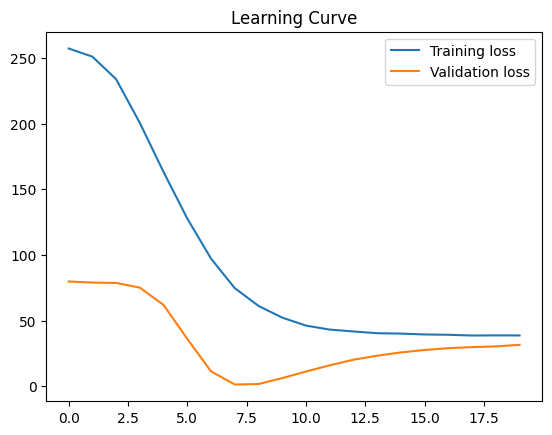

In [ ]:
plt.plot(yay.history['loss'], label='Training loss')
plt.plot(yay.history['val_loss'], label='Validation loss')
plt.title("Learning Curve")
plt.legend()

Smoothness: great! Our model is learning consistently/gradually<br>
Convergence: Seems like we converge around epoch 12. This means we don't need to worry about furthering learning (eg increasing epochs). We don't need to add more data, so overfitting doesn't seem to be a pressing issue here. Some underfitting - our model and/or our data is too simple, it seems.<br>
Generalization: our two curves seem to be pretty similar to each other in terms of complexity and distance.

Not great, not terrible. Let's evaluate on the test set:

In [ ]:
dropped_X_test = X_test.drop(labels ='date', axis=1)

In [ ]:
dropped_X_test, Y_test = np.array(dropped_X_test), np.array(Y_test)

In [ ]:
dropped_X_test = dropped_X_test.reshape(dropped_X_test.shape[0], 1, dropped_X_test.shape[1])

In [ ]:
results = model.evaluate(dropped_X_test, Y_test)

7/7 [==============================] - 0s 4ms/step - loss: 22.7417 - mae: 4.7195


In [ ]:
model.predict(dropped_X_test)

7/7 [==============================] - 1s 3ms/step


array([[[14.506871 ]],

       [[14.603237 ]],

       [[14.547205 ]],

       [[14.37278  ]],

       [[14.492397 ]],

       [[14.4087715]],

       [[14.425367 ]],

       [[14.514389 ]],

       [[14.488148 ]],

       [[14.514794 ]],

       [[14.537231 ]],

       [[14.49737  ]],

       [[14.470146 ]],

       [[14.484943 ]],

       [[14.473618 ]],

       [[14.553067 ]],

       [[14.509836 ]],

       [[14.4930525]],

       [[14.388295 ]],

       [[14.461172 ]],

       [[14.295006 ]],

       [[14.338115 ]],

       [[14.408719 ]],

       [[14.526117 ]],

       [[14.505481 ]],

       [[14.483749 ]],

       [[14.428448 ]],

       [[14.489024 ]],

       [[14.335369 ]],

       [[14.379367 ]],

       [[14.36672  ]],

       [[14.40681  ]],

       [[14.508755 ]],

       [[14.401493 ]],

       [[14.397484 ]],

       [[14.230456 ]],

       [[14.234993 ]],

       [[14.190427 ]],

       [[14.23793  ]],

       [[14.274546 ]],

       [[14.013271 ]],

       [[14.7692

Based on this, we can assume that the model generalizes as well as it can to the real world. This means we need to work on training for better metrics in general. Back to EDA!